Name: Harshith Akkapelli

Task-1A: Binary Classification

Dataset Link: [Airline Passenger Satisfaction](https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction)

Install pycaret

In [ ]:
!pip install pycaret[full]

In [ ]:
"""Mount Google Drive to access your data"""
from google.colab import drive #Import library
drive.mount('/content/drive') #Mount it

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
"""IMPORT DATA AND HANDLE MISSING VALUES"""
import pandas as pd #Import Library

"""Function to load and remove na valued rows"""
def importData(url):
  print("Started Reading Data")
  getData = pd.read_csv(url)
  print("Completed Reading Data")
  print(getData.head())
  print("Removing na values")
  getData = getData.dropna()
  print("Removed rows with na values")
  return getData

url = '/content/drive/MyDrive/1a.csv'
inputData = importData(url) #Call the Function

Started Reading Data
Completed Reading Data
   Unnamed: 0      id  Gender      Customer Type  Age   Type of Travel  \
0           0   70172    Male     Loyal Customer   13  Personal Travel   
1           1    5047    Male  disloyal Customer   25  Business travel   
2           2  110028  Female     Loyal Customer   26  Business travel   
3           3   24026  Female     Loyal Customer   25  Business travel   
4           4  119299    Male     Loyal Customer   61  Business travel   

      Class  Flight Distance  Inflight wifi service  \
0  Eco Plus              460                      3   
1  Business              235                      3   
2  Business             1142                      2   
3  Business              562                      2   
4  Business              214                      3   

   Departure/Arrival time convenient  ...  Inflight entertainment  \
0                                  4  ...                       5   
1                                  2  ... 

In [ ]:
from pycaret.classification import *

"""Function to set up the environment"""
def doSetUpOfPycaret(inputData,targetColumn):
  print("Setting up the environment")
  s = setup(inputData, target = targetColumn,normalize = True,normalize_method="zscore") #Normalization of data is important
  print("Environment is set up")
  return s

targetColumn = "satisfaction" #Target Column name
s = doSetUpOfPycaret(inputData,targetColumn)#Call the Function

Setting up the environment


,Description,Value
0,Session id,7795
1,Target,satisfaction
2,Target type,Binary
3,Target mapping,"neutral or dissatisfied: 0, satisfied: 1"
4,Original data shape,"(103594, 25)"
5,Transformed data shape,"(103594, 27)"
6,Transformed train set shape,"(72515, 27)"
7,Transformed test set shape,"(31079, 27)"
8,Ordinal features,3
9,Numeric features,20


Environment is set up


Starting Training of models


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9648,0.9952,0.9435,0.9746,0.9588,0.9282,0.9285,7.0140
catboost,CatBoost Classifier,0.9645,0.9955,0.9454,0.9719,0.9585,0.9275,0.9278,23.0020
xgboost,Extreme Gradient Boosting,0.9632,0.9950,0.9441,0.9703,0.9570,0.9249,0.9252,11.1400
rf,Random Forest Classifier,0.9626,0.9938,0.9400,0.9729,0.9562,0.9236,0.9241,10.4500
et,Extra Trees Classifier,0.9612,0.9933,0.9379,0.9716,0.9544,0.9206,0.9211,9.3520
dt,Decision Tree Classifier,0.9437,0.9429,0.9369,0.9335,0.9352,0.8855,0.8855,1.4660
gbc,Gradient Boosting Classifier,0.9436,0.9882,0.9215,0.9470,0.9341,0.8848,0.8851,16.1810
ada,Ada Boost Classifier,0.9286,0.9787,0.9126,0.9220,0.9173,0.8545,0.8546,5.4900
knn,K Neighbors Classifier,0.9238,0.9651,0.8748,0.9454,0.9087,0.8435,0.8454,5.5710
lr,Logistic Regression,0.8757,0.9273,0.8376,0.8708,0.8538,0.7458,0.7463,1.9410


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

Completed Training of models
Printing Confusion Matrix of final model


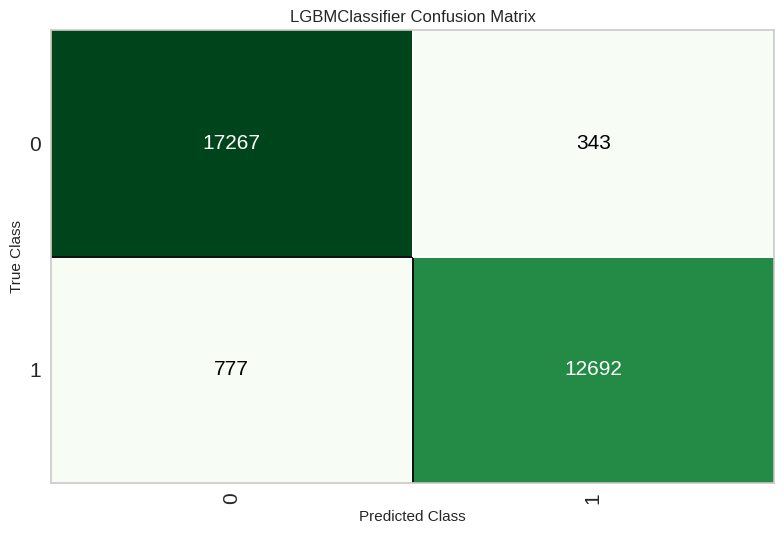

Printed Confusion Matric of final model
Plotting accuracy curves of final model


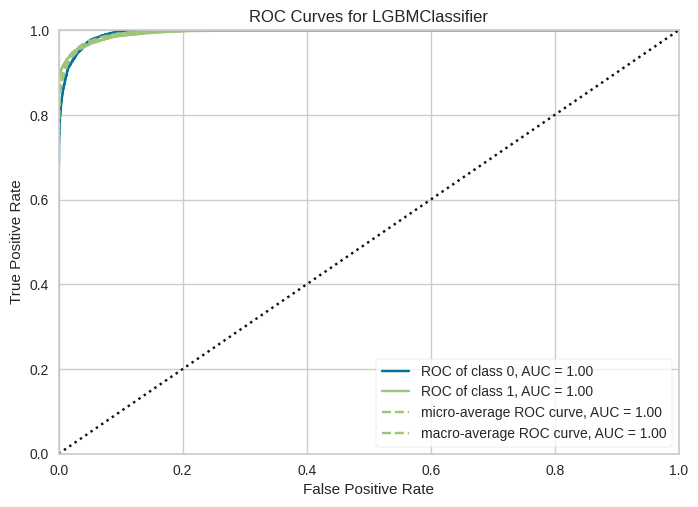

Plotte accuracy curves of final model
Feature Importance


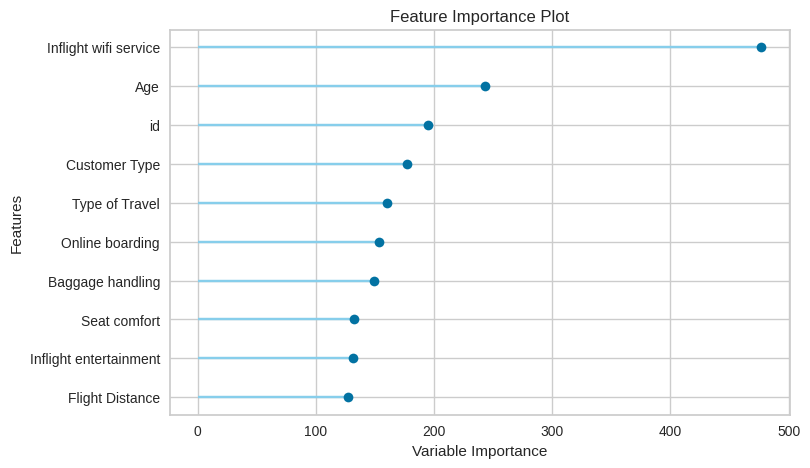

import numpy as np
from google.colab import autoviz

def categorical_histogram(df, colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  df.groupby(colname).size().plot(kind='barh', color=sns.palettes.mpl_palette(mpl_palette_name), figsize=(8*figscale, 4.8*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  return autoviz.MplChart.from_current_mpl_state()

chart = categorical_histogram(_df_0, *['  '], **{})
chart

In [ ]:
"""Function to Train and Evaluate the models"""
def trainAndBenchmarkModels():
  #Training Phase
  print("Starting Training of models")
  finalModel = compare_models()
  print("Completed Training of models")

  #Confusion Matrix
  print("Printing Confusion Matrix of final model")
  plot_model(finalModel, plot = 'confusion_matrix')
  print("Printed Confusion Matric of final model")

  #Accuracy Curves
  print("Plotting accuracy curves of final model")
  plot_model(finalModel, plot = 'auc')
  print("Plotte accuracy curves of final model")

  #Feature Importance
  print("Feature Importance")
  plot_model(finalModel,plot='feature')

  #Return model
  return finalModel
finalModel = trainAndBenchmarkModels()

___

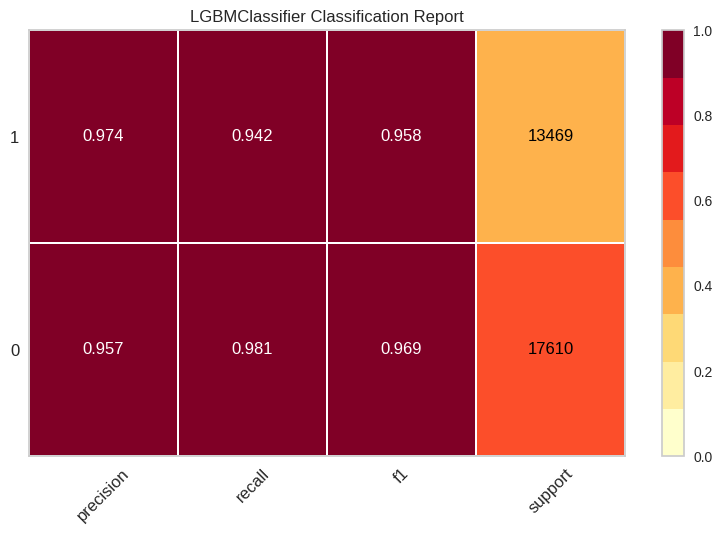

In [ ]:
"""Function to generate class report for final model"""
def classReport(finalModel,typeOfPlot):
  plot_model(finalModel, plot = typeOfPlot)
typeOfPlot = "class_report"
classReport(finalModel,typeOfPlot)

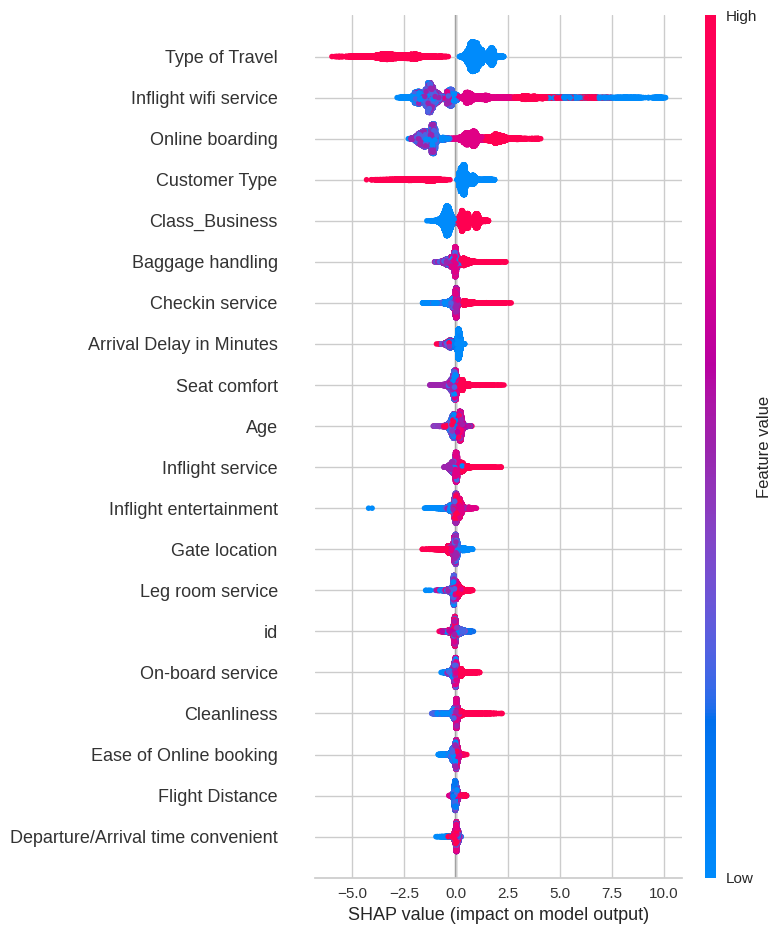

In [ ]:
"""Function to interpret summary interpretation"""
def interpretModel(finalModel,typeOfInterpret):
  interpret_model(finalModel, plot = typeOfInterpret)


typeOfInterpret = "summary"
interpretModel(finalModel,typeOfInterpret)
"""Reason for one example"""
interpret_model(finalModel, plot = 'reason', observation = 5)

In [ ]:
"""Function to test the model"""
def testModel(finalModel):
  test = predict_model(finalModel)
  print(test.head())
testModel(finalModel)#Call the function

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9640,0.9952,0.9423,0.9737,0.9577,0.9263,0.9267


       Unnamed: 0      id  Gender   Customer Type  Age   Type of Travel  \
34867       34867   40623  Female  Loyal Customer   47  Personal Travel   
59655       59655  101669  Female  Loyal Customer   24  Personal Travel   
58131       58131   24836  Female  Loyal Customer   65  Personal Travel   
95898       95898   79229    Male  Loyal Customer   56  Business travel   
58382       58382   71372  Female  Loyal Customer   34  Business travel   

          Class  Flight Distance  Inflight wifi service  \
34867       Eco              391                      3   
59655       Eco             2106                      5   
58131       Eco              861                      2   
95898  Business             1521                      5   
58382  Business              258                      1   

       Departure/Arrival time convenient  ...  Leg room service  \
34867                                  5  ...                 3   
59655                                  5  ...               

In [ ]:
eda() #Perform eda analysis

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (103594, 27)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    26 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification problem #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['Unnamed 0', ...], value='Unnamed 0')
    [1] ParamFunction(function, _pane=HoloViews)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['Unnamed 0', ...], value='Unnamed 0')
        [1] Select(name='Y-Axis', options=['Unnamed 0', ...], value='id')
        [2] Select(name='Color', options=['None', 'satisfaction'], value='None')
    [1] ParamFunction(function, _pane=HoloViews)

Column
    [0] Row
        [0] HoloViews(DynamicMap, height=400, sizing_mode='fixed', width=600)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['Gender', 'Customer Type'...], value='Gender', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap, height=400, sizing_mode='fixed', width=600)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['Departure Delay in Minut...], value='Departure Delay i..., width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay, height=800, sizing_mode='fixed', width=1200)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['Gender', 'Customer Type'...], value='Gender')
        [1] Select(name='Y-Axis', options=['Unnamed 0', ...], value='Unnamed 0')
    [1] ParamFunction(function, _pane=HoloViews)

Time to run AutoViz (in seconds) = 24


In [ ]:
save_model(finalModel, 'final_pipeline') #Save the model

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/tmp/joblib),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['Unnamed: 0', 'id', 'Age',
                                              'Flight Distance',
                                              'Inflight wifi service',
                                              'Departure/Arrival time '
                                              'convenient',
                                              'Ease of Online booking',
                                              'Gate loca...
                  LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, importance_type='split',
                                 learning_